**Lab 5: FIR Filtering 2**

The goal of this lab is to study the response of FIR filters to inputs such as complex exponentials and sinusoids. In the experiments of this lab, you will use `np.convolve()` to implement filters and `freqz()` to obtain the filter’s frequency response. As a result, you should learn how to characterize a filter by knowing how it reacts to different frequency components in the input.
This lab also introduces two practical filters: bandpass filters and nulling filters.
Bandpass filters can be used to detect and extract information from sinusoidal signals,
e.g., tones in a touch-tone telephone dialer. Nulling filters can be used to remove
sinusoidal interference, e.g., jamming signals in a radar.

In [ ]:
!git clone https://github.com/pzinemanas/sis1lab.git

import os
import numpy as np
import librosa
import IPython.display as ipd
from scipy import signal
import matplotlib.pyplot as plt
from IPython.display import Audio

from sis1lab.util import load_audio, plot_signals, plot_spectrogram, plot_mean_spectrogram

fatal: destination path 'sis1lab' already exists and is not an empty directory.


1.1. First, let's replicate what we did until now. Copy the functions synthesize and envelope and obtain the synthesis from the last lab.

In [ ]:
# Loading reference audio
!git clone https://github.com/Alejandro-FA/sis1_group0.git
filepath = "./sis1_group0/resources/Mandolin_Tuner.wav"
ref, fs = load_audio(filepath)

fatal: destination path 'sis1_group0' already exists and is not an empty directory.


In [ ]:
# Define envolope and synthesize functions
def averaging_filter(x, N, mode):
  b = np.array([1.0/N]*N)
  y = np.convolve(b, x, mode=mode)
  
  return y

def envelope(x, N):
  x_rect = np.abs(x)
  y = averaging_filter(x_rect, N, 'same')

  return y

def synthesize(f0, phi, Ak, t):
  y = 0
  for k in range(1, len(Ak) + 1):
    y += Ak[k-1] * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)
  return y

In [ ]:
# Compute envelope
N = 500;
env = envelope(ref, N)

In [ ]:
# Compute synthesized signal
weights = [1, 0.5196, 0.3379, 0.7774, 0.2000, 0.1077, 0.8555, 0.01760, 0.1553, 
           0.0467, 0.0625, 0.00736, 0.00730, 0.0096, 0.01677, 0.0026, 0.0039,
           0.0014, 0.0014, 0.000999, 0.0000887, 0.00256, 0.0000869, 0.0000536
           , 0.0000513, 0.0000757, 0.0000226, 0.0000362, 0.0000203, 0.0000407
           , 0.0000268, 0.0000511, 0.00903]

Ts = 1/float(fs)
t = np.arange(0, len(env)*Ts, Ts)
f_0 = 296.08
dt = 1.004338 - 1.003 #Data from Lab 2
phi = -np.pi*f_0*2*dt  #Data from Lab 2

synth_signal = synthesize(f_0, phi, weights, t)

In [ ]:
# Apply envelope to synthesized signal (as in the previous lab)
synth_env = env*synth_signal

1.2 Plot both reference and synthesised signal.

In [ ]:
# We plot the signal in 2 different time intervals in order to have more information
plot_signals([ref, synth_env], fs, name=['reference', 'synthesis lab 4 '], mode='lines')
plot_signals([ref, synth_env], fs, name=['reference', 'synthesis lab 4 '],t_start=1, t_end=1.05, mode='lines')

---

**2. Averaging filter**

Now let's analyze the frequency response of the average filter used in the envelope function. The Scipy Python module has a function called *freqz()* for computing the frequency
response of a discrete-time LTI system. The following Python statements show how to
use freqz to compute and plot both the magnitude (absolute value) and the phase of
the frequency response of a four-point averaging system as a function of ω in the range − π ≤ ω ≤ π :

In [ ]:
from sis1lab.util import plot_frequency_response

ww = np.arange(-np.pi, np.pi, np.pi/500)
_, HH = signal.freqz([1/4]*4, 1, ww)

plot_frequency_response(ww, HH)

For FIR filters, the second argument of `freqz(-, 1,- )` must always be equal to 1. The frequency vector ww should cover an interval of length 2π for ω , and its spacing must be fine enough to give a smooth curve for H(ejω) . Note: we will always use capital H for the frequency response.

2.1 Use the `freqz` and `plot_frequency_response` functions to plot the frequency response of the averaging filter of your envelope function.



In [ ]:
# We only have to change the coefficients of the 4-point averaging filter by our
# N-point averaging filter (with N = 500).
ww = np.arange(-np.pi, np.pi, np.pi/5000)
_, HH = signal.freqz([1/N]*N, 1, ww)

plot_frequency_response(ww, HH)

2.2 Looking at the frequency responses, what are the main differences between your filter and the four-point averaging filter. What happens when the value N is increased?

First of all, the peak of the magnitude is thinner in our case. In fact, it seems as if only really low frequencies can go through this filter (so it is a low-pass filter). This is totally reasonable, since an averaging filter with 500 points is used to see the underlying trend of a signal and delete the small variations (i.e. the high frequencies). A 4-point averaging filter does something similar, but to a much lower degree.



---

**3. Nulling Filters for Rejection**

Nulling filters are filters that completely eliminate some frequency components. If the frequency is $\omega=0$ or $\omega=\pi$ then a two-point FIR filter will do the nulling. The simplest possible general nulling filter can have as few as three coefficients. If $\omega_n$ is the desired nulling frequency, then the following length-3 FIR filter

$$
y[n] = x[n] - 2\cos(\omega_n)x[n-1] + x[n-2] 
$$

will have a zero in its frequency response at $\omega=\omega_n$. For example, a filter designed to completely eliminate signals of the form $e^{j0.5\pi}$ would have the following coefficients because we would pick the desired nulling frequency to be $\omega_n = 0.5\pi$

$$
b_0 = 1, \quad b1=-2cos(\omega_n)=0, \quad b_2=1
$$

3.1 Use the following function to add an interference in your reference signal. Name the corrupted signal as `x_interf`.

In [ ]:
def add_interference(x, fs):
  t = np.linspace(0, len(x)*1/float(fs), len(x))
  y = x + (np.amax(x)/10)*np.sin(2*np.pi*1000*t)
  return y

In [ ]:
# Add interference to our synthesized signal
x_interf = add_interference(synth_env , fs)

3.2 Plot both the reference signal and the corrupted signal and listen to the latter one. 

In [ ]:
plot_signals([ref, x_interf], fs, name=['reference', 'corrupted signal '], mode='lines')

In [ ]:
# Reference signal audio (for comparison purposes)
Audio(np.real(synth_env), rate=fs)

In [ ]:
# Corrupted signal audio.
Audio(np.real(x_interf), rate=fs)

We can hear that a high-pitched sound has been added to the whole signal.

3.3 Compare the spectrograms of the reference signal and the interference signal. 

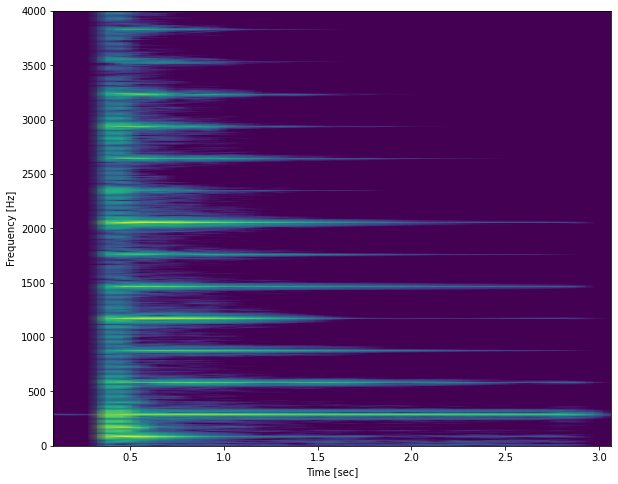

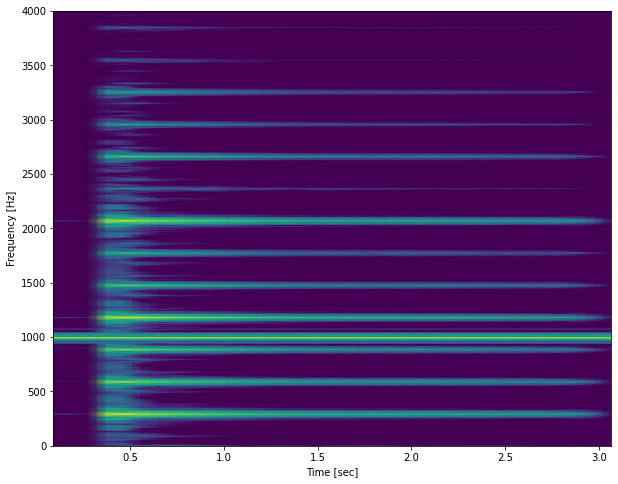

In [ ]:
# Reference signal spectrogram
window_length = 8192
ff, tt, S = signal.spectrogram(ref, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()

# Corrupted signal spectrogram
window_length = 8192
ff, tt, S = signal.spectrogram(x_interf, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()

The difference between both spectograms is that **we have added a frequency component at 1000 Hz** (as intended by the `add_interference` function).

3.4. Create a function `remove_interference(x, fs)` that applies a nulling filter devised to remove the interference at 1000 Hz. 

Note: remember that a frequency can be converted to the normalized radian frequncy by: $\omega_n = 2\pi f_n/f_s$

In [ ]:
def remove_interference(x, fs):
  """Applies nulling filter to remove an interference at 1000 Hz

  Parameters
  ----------
  x : np.array
      The input signal in the form of a numpy array
  fs : int or float
      Frequency rate in Hz

  Returns
  -------
  y : np.array
      The output of the filter

  """

  target_freq = 1000
  wn = 2*np.pi*target_freq/fs
  b = [1,-2*np.cos(wn) , 1]

  return np.convolve(b, x, mode='full')

  

3.5 Use the `remove_interference` funcion to clean the corrupted signal,  `x_interf`. Call the output as `x_clean`. Compare the spectrograms of both signals. Explain the result.

In [ ]:
# Apply the remove interference function to the corrupted signal
x_clean = remove_interference(x_interf, fs)

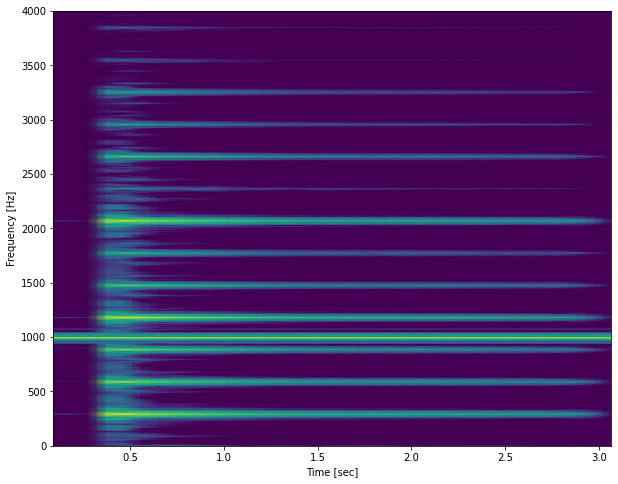

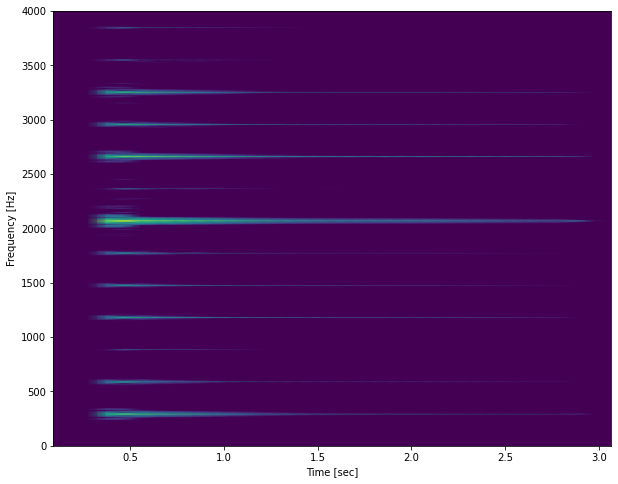

In [ ]:
# Spectrogram of the corrupted signal
window_length = 8192
ff, tt, S = signal.spectrogram(x_interf, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()

# Spectrogram of the cleaned signal
window_length = 8192
ff, tt, S = signal.spectrogram(x_clean, fs, nperseg=window_length, noverlap=window_length/2)

plt.figure(figsize=(10,8))
plot_spectrogram(ff, tt, S)
plt.ylim([0,4000])
plt.show()

We first see that the **frequency component at 1000 Hz has been completely removed** (as we intended with the `remove_interference` function). But there's something unexpected: **other frequencies have also been affected**. This might be explained by the fact that the nullying filter is not perfect, and it does not only affect the target frequency.

In [ ]:
# Original / reference sound (for comparison purposes):
Audio(np.real(ref), rate=fs)

In [ ]:
# Lab 4 result (envelope) (for comparison purposes):
Audio(np.real(synth_env), rate=fs)

In [ ]:
# Lab 5 result (adding and removing interference)
Audio(np.real(x_clean), rate=fs)

It seems that the result of this lab is even better than the previous one. Perhaps this is due to the fact that we have reduced some noise. On the other hand, we can hear that a high-pitched sound has been added (which is uncomfortable).